In [2]:
import os
import cv2
import datetime
import numpy as np

import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.image import img_to_array
from tensorflow.keras.preprocessing.image import load_img
from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.callbacks import ModelCheckpoint, ReduceLROnPlateau
from sklearn.preprocessing import LabelBinarizer
from tensorflow.keras import layers as L

import pickle

In [4]:
# import os
# import json
# from pathlib import Path

# # === INPUTS ===
# ann_file = "excavator/cleaned_detection_annotations_valid.json" 
# img_root = Path("excavator/valid/")  # folder containing images
# OUTPUT_DIR = Path("per_class_txts")
# OUTPUT_DIR.mkdir(exist_ok=True)

# # === LOAD COCO JSON ===
# with open(ann_file, "r") as f:
#     coco = json.load(f)

# # Build class list (COCO categories)
# categories = {cat["id"]: cat["name"] for cat in coco["categories"]}
# all_classes = sorted(categories.values())

# # Create dict for each class to collect lines
# class_lines = {cls: [] for cls in all_classes}

# # Map image_id → filename
# image_map = {img["id"]: img["file_name"] for img in coco["images"]}

# # === PARSE ANNOTATIONS ===
# for ann in coco["annotations"]:
#     image_id = ann["image_id"]
#     category_id = ann["category_id"]
#     bbox = ann["bbox"]  # [x, y, width, height]
#     filename = image_map[image_id]

#     xmin = int(bbox[0])
#     ymin = int(bbox[1])
#     xmax = int(bbox[0] + bbox[2])
#     ymax = int(bbox[1] + bbox[3])

#     cls_name = categories[category_id]
#     line = f"{filename},{xmin},{ymin},{xmax},{ymax}"
#     class_lines[cls_name].append(line)

# # === WRITE PER-CLASS TXT FILES ===
# for cls_name, lines in class_lines.items():
#     if not lines:
#         continue
#     out_file = OUTPUT_DIR / f"res_{cls_name}.txt"
#     with open(out_file, "w") as f:
#         f.write("\n".join(lines))
#     print(f"Saved {len(lines)} entries -> {out_file}")

# # === WRITE CLASSES LIST ===
# classes_txt = OUTPUT_DIR / "classes.txt"
# with open(classes_txt, "w") as f:
#     f.write("classes = " + str(all_classes))

# print(f"\n✅ Classes saved to {classes_txt} in one-line Python list format")

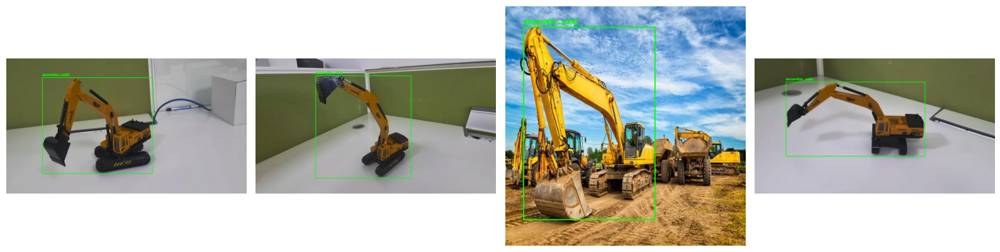

In [3]:
import os
import random
import cv2
import matplotlib.pyplot as plt
from pathlib import Path

# === CONFIG ===
IMG_DIR = Path("/kaggle/input/excavator/excavator/valid")          # image folder
TXT_FILE = Path("/kaggle/input/excavator/excavator/res_excavator_valid.txt")  
NUM_SAMPLES = 4

# === LOAD TXT ===
with open(TXT_FILE, "r") as f:
    lines = [line.strip() for line in f.readlines() if line.strip()]

# === PICK RANDOM ===
samples = random.sample(lines, min(NUM_SAMPLES, len(lines)))

# === VISUALIZE SIDE BY SIDE ===
plt.figure(figsize=(16, 6))

for i, line in enumerate(samples):
    fname, xmin, ymin, xmax, ymax = line.split(",")
    xmin, ymin, xmax, ymax = map(int, [xmin, ymin, xmax, ymax])
    img_path = IMG_DIR / fname
    img = cv2.imread(str(img_path))
    if img is None:
        continue

    # draw bbox
    cv2.rectangle(img, (xmin, ymin), (xmax, ymax), (0, 255, 0), 2)
    cv2.putText(img, TXT_FILE.stem.replace("res_", ""), (xmin, max(ymin - 10, 20)),
                cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0, 255, 0), 2)

    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.subplot(1, NUM_SAMPLES, i + 1)
    plt.imshow(img_rgb)
    plt.axis("off")

plt.tight_layout()
plt.show()

In [4]:
import os
import cv2
import numpy as np
from sklearn.preprocessing import LabelBinarizer
from tensorflow.keras.preprocessing.image import load_img, img_to_array

def load_dataset(ann_path, images_path, classes):
    data = []
    labels = []
    bboxes = []
    imagePaths = []

    print(f"\nLoading from: {ann_path}")
    for cl in classes:
        ann_path_new = ann_path  # already full path (e.g., res_excavator_train.txt)
        print(f"Reading: {ann_path_new}")
        
        rows = open(ann_path_new).read().strip().split("\n")
        
        for idx, row in enumerate(rows):
            row = row.split(",")
            filename = row[0]
            coords = [int(c) for c in row[1:]]
            label = cl
            
            image_path = os.path.sep.join([images_path, filename])
            if not os.path.exists(image_path):
                print(f"[WARN] Missing: {image_path}")
                continue
            
            image = cv2.imread(image_path)
            (h, w) = image.shape[:2]
            
            # normalize bbox
            Xmin = float(coords[0]) / w
            Ymin = float(coords[1]) / h
            Xmax = float(coords[2]) / w
            Ymax = float(coords[3]) / h
            
            # resize image
            image = load_img(image_path, target_size=(512, 512))
            image = img_to_array(image)
            
            data.append(image)
            labels.append(label)
            bboxes.append((Xmin, Ymin, Xmax, Ymax))
            imagePaths.append(image_path)

    # convert arrays
    data = np.array(data, dtype="float32") / 255.0
    labels = np.array(labels)
    bboxes = np.array(bboxes, dtype="float32")
    imagePaths = np.array(imagePaths)

    print(f"✅ Loaded {len(data)} samples from {ann_path}")
    return data, labels, bboxes, imagePaths


# === CONFIG ===
classes = ['excavator']
print(f"Total classes: {len(classes)}")

# TRAIN
train_ann = "/kaggle/input/excavator/excavator/res_excavator_train.txt"
train_img_dir = "/kaggle/input/excavator/excavator/train"
(trainImages, trainLabels, trainBBoxes, trainPaths) = load_dataset(train_ann, train_img_dir, classes)

# VALID
valid_ann = "/kaggle/input/excavator/excavator/res_excavator_valid.txt"
valid_img_dir = "/kaggle/input/excavator/excavator/valid"
(testImages, testLabels, testBBoxes, testPaths) = load_dataset(valid_ann, valid_img_dir, classes)

# === LABEL ENCODING ===
lb = LabelBinarizer()
trainLabels = lb.fit_transform(trainLabels)
testLabels = lb.transform(testLabels)

# Force 2 columns: [background, excavator]
if trainLabels.shape[1] == 1:
    trainLabels = np.hstack([1 - trainLabels, trainLabels])
    testLabels = np.hstack([1 - testLabels, testLabels])

print("\nDataset Summary:")
print(f"Train: {trainImages.shape}, {trainLabels.shape}, {trainBBoxes.shape}")
print(f"Valid: {testImages.shape}, {testLabels.shape}, {testBBoxes.shape}")

Total classes: 1

Loading from: /kaggle/input/excavator/excavator/res_excavator_train.txt
Reading: /kaggle/input/excavator/excavator/res_excavator_train.txt
✅ Loaded 657 samples from /kaggle/input/excavator/excavator/res_excavator_train.txt

Loading from: /kaggle/input/excavator/excavator/res_excavator_valid.txt
Reading: /kaggle/input/excavator/excavator/res_excavator_valid.txt
✅ Loaded 54 samples from /kaggle/input/excavator/excavator/res_excavator_valid.txt

Dataset Summary:
Train: (657, 512, 512, 3), (657, 2), (657, 4)
Valid: (54, 512, 512, 3), (54, 2), (54, 4)


In [6]:
inputs = L.Input((512, 512, 3))

""" Backbone """
backbone = EfficientNetB0(
    include_top=False,
    weights="imagenet",
    input_tensor=inputs,
)
backbone.trainable = True
# backbone.summary()

x = backbone.output

# Shared feature map
shared = L.Conv2D(256, 3, padding="same", activation="relu")(x)

# Classification head (global)
cls = L.GlobalAveragePooling2D()(shared)
cls = L.Dropout(0.5)(cls)
cls = L.Dense(2, activation="softmax", name="class_label")(cls)

# Bounding box head (spatial)
bbox = L.Conv2D(256, 3, padding="same", activation="relu")(shared)
bbox = L.Conv2D(128, 3, padding="same", activation="relu")(bbox)
bbox = L.GlobalAveragePooling2D()(bbox)     # reduces spatial map but keeps encoded location bias
bbox = L.Dense(64, activation="relu")(bbox)
bbox = L.Dropout(0.3)(bbox)
bbox = L.Dense(4, activation="sigmoid", name="bounding_box")(bbox)

model = Model(inputs=[inputs], outputs=[bbox, cls])

In [7]:
INIT_LR = 1e-4
NUM_EPOCHS = 50
BATCH_SIZE = 32

In [8]:
from tensorflow.keras.losses import Huber
losses = {
    "class_label": "categorical_crossentropy",
    "bounding_box": Huber()  # "mean_squared_error",
}
lossWeights = {
    "class_label": 0.3,
    "bounding_box": 1.0
}

In [9]:
trainTargets = {
    "class_label": trainLabels,
    "bounding_box": trainBBoxes
}
testTargets = {
    "class_label": testLabels,
    "bounding_box": testBBoxes
}

In [10]:
opt = Adam(INIT_LR)

model.compile(loss=losses, 
              optimizer=opt, 
              metrics=["accuracy", "accuracy"], 
              loss_weights=lossWeights)

checkpoint_filepath = "EfficientNetB0_v2_bbox_regression_excavator.weights.h5"
""" Training """
callbacks = [
    ModelCheckpoint(checkpoint_filepath, monitor="val_loss", save_best_only=True, save_weights_only=True, verbose=1),
    ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=3, min_lr=1e-7, verbose=1),
]
print(model.summary())

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_1       │ (None, 512, 512,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ rescaling_2         │ (None, 512, 512,  │          0 │ input_layer_1[0]… │
│ (Rescaling)         │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ normalization_1     │ (None, 512, 512,  │          7 │ rescaling_2[0][0] │
│ (Normalization)     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ rescaling_3         │ (None, 512, 512,  │          0 │ normalization_1[… │
│ (Rescaling)         │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ stem_conv_pad       │ (None, 513, 513,  │          0 │ rescaling_3[0][0] │
│ (ZeroPadding2D)     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ stem_conv (Conv2D)  │ (None, 256, 256,  │        864 │ stem_conv_pad[0]… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ stem_bn             │ (None, 256, 256,  │        128 │ stem_conv[0][0]   │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ stem_activation     │ (None, 256, 256,  │          0 │ stem_bn[0][0]     │
│ (Activation)        │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_dwconv      │ (None, 256, 256,  │        288 │ stem_activation[… │
│ (DepthwiseConv2D)   │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_bn          │ (None, 256, 256,  │        128 │ block1a_dwconv[0… │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_activation  │ (None, 256, 256,  │          0 │ block1a_bn[0][0]  │
│ (Activation)        │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_se_squeeze  │ (None, 32)        │          0 │ block1a_activati… │
│ (GlobalAveragePool… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_se_reshape  │ (None, 1, 1, 32)  │          0 │ block1a_se_squee… │
│ (Reshape)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_se_reduce   │ (None, 1, 1, 8)   │        264 │ block1a_se_resha… │
│ (Conv2D)            │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_se_expand   │ (None, 1, 1, 32)  │        288 │ block1a_se_reduc… │
│ (Conv2D)            │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_se_excite   │ (None, 256, 256,  │          0 │ block1a_activati… │
│ (Multiply)          │ 32)               │            │ block1a_se_expan… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_project_co… │ (None, 256, 256,  │        512 │ block1a_se_excit

 Total params: 7,893,097 (30.11 MB)

 Trainable params: 7,851,074 (29.95 MB)

 Non-trainable params: 42,023 (164.16 KB)

None


In [11]:
H = model.fit(
    trainImages, trainTargets,
    validation_data=(testImages, testTargets),
    batch_size=BATCH_SIZE,
    epochs=NUM_EPOCHS,
    callbacks=callbacks,
    verbose=1)

Epoch 1/50


/usr/local/lib/python3.11/dist-packages/keras/src/models/functional.py:237: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: ['keras_tensor_248']
Received: inputs=Tensor(shape=(None, 512, 512, 3))
  warnings.warn(msg)
I0000 00:00:1759844581.018390     109 service.cc:148] XLA service 0x7d3638005900 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1759844581.019233     109 service.cc:156]   StreamExecutor device (0): Tesla T4, Compute Capability 7.5
I0000 00:00:1759844581.019253     109 service.cc:156]   StreamExecutor device (1): Tesla T4, Compute Capability 7.5
I0000 00:00:1759844586.099677     109 cuda_dnn.cc:529] Loaded cuDNN version 90300
E0000 00:00:1759844592.175786     109 gpu_timer.cc:82] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1759844592.523681     109 gpu_timer.cc:82] Delay ke

20/21 ━━━━━━━━━━━━━━━━━━━━ 0s 603ms/step - bounding_box_accuracy: 0.4567 - bounding_box_loss: 0.0241 - class_label_accuracy: 0.7851 - class_label_loss: 0.4265 - loss: 0.1521

E0000 00:00:1759844659.295175     108 gpu_timer.cc:82] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1759844659.559560     108 gpu_timer.cc:82] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1759844673.138437     108 gpu_timer.cc:82] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1759844673.301369     108 gpu_timer.cc:82] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1759844673.880300     108 gpu_timer.cc:82] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:0

21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - bounding_box_accuracy: 0.4610 - bounding_box_loss: 0.0238 - class_label_accuracy: 0.7924 - class_label_loss: 0.4123 - loss: 0.1475   

E0000 00:00:1759844711.403048     109 gpu_timer.cc:82] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1759844711.698577     109 gpu_timer.cc:82] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.



Epoch 1: val_loss improved from inf to 1.91299, saving model to EfficientNetB0_v2_bbox_regression_excavator.weights.h5
21/21 ━━━━━━━━━━━━━━━━━━━━ 194s 4s/step - bounding_box_accuracy: 0.4649 - bounding_box_loss: 0.0235 - class_label_accuracy: 0.7990 - class_label_loss: 0.3994 - loss: 0.1434 - val_bounding_box_accuracy: 0.7407 - val_bounding_box_loss: 0.0168 - val_class_label_accuracy: 0.0000e+00 - val_class_label_loss: 6.3236 - val_loss: 1.9130 - learning_rate: 1.0000e-04
Epoch 2/50
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 667ms/step - bounding_box_accuracy: 0.5721 - bounding_box_loss: 0.0107 - class_label_accuracy: 1.0000 - class_label_loss: 7.1880e-05 - loss: 0.0107
Epoch 2: val_loss improved from 1.91299 to 1.31922, saving model to EfficientNetB0_v2_bbox_regression_excavator.weights.h5
21/21 ━━━━━━━━━━━━━━━━━━━━ 16s 734ms/step - bounding_box_accuracy: 0.5711 - bounding_box_loss: 0.0107 - class_label_accuracy: 1.0000 - class_label_loss: 7.3464e-05 - loss: 0.0107 - val_bounding_box_accuracy: 0.

In [12]:
f = open("lb.pickle", "wb")
f.write(pickle.dumps(lb))
f.close()

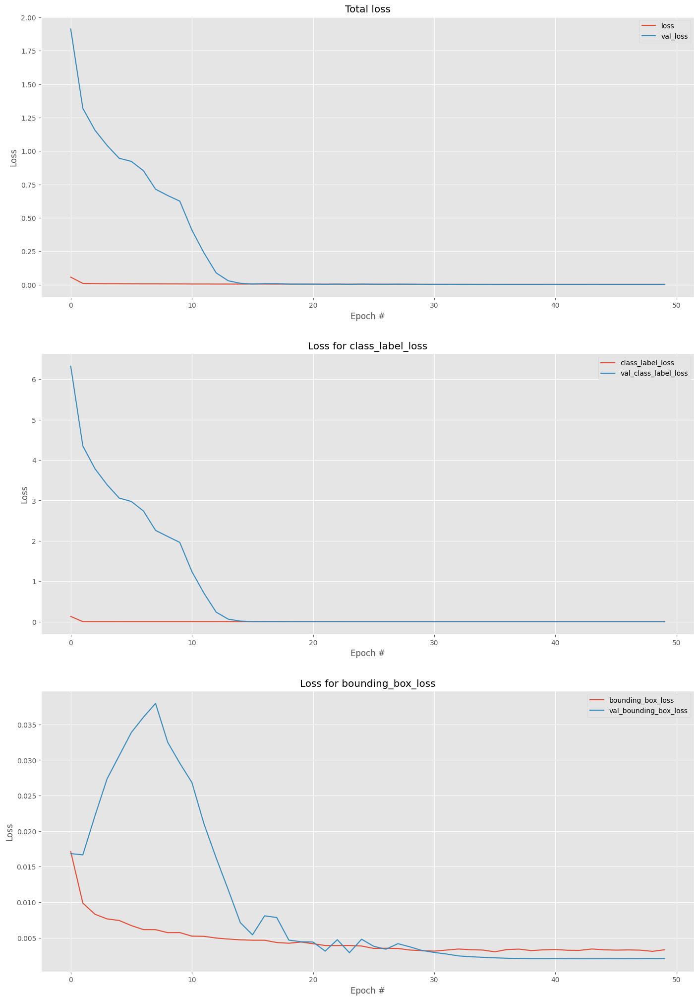

In [13]:
lossNames = ["loss", 
             "class_label_loss", 
             "bounding_box_loss"]

N = np.arange(0, NUM_EPOCHS)
plt.style.use("ggplot")
(fig, ax) = plt.subplots(3, 1, figsize=(17, 25))

# loop over the loss names
for (i, l) in enumerate(lossNames):
    # plot the loss for both the training and validation data
    title = "Loss for {}".format(l) if l != "loss" else "Total loss"
    ax[i].set_title(title)
    ax[i].set_xlabel("Epoch #")
    ax[i].set_ylabel("Loss")
    ax[i].plot(N, H.history[l], label=l)
    ax[i].plot(N, H.history["val_" + l], label="val_" + l)
    ax[i].legend()

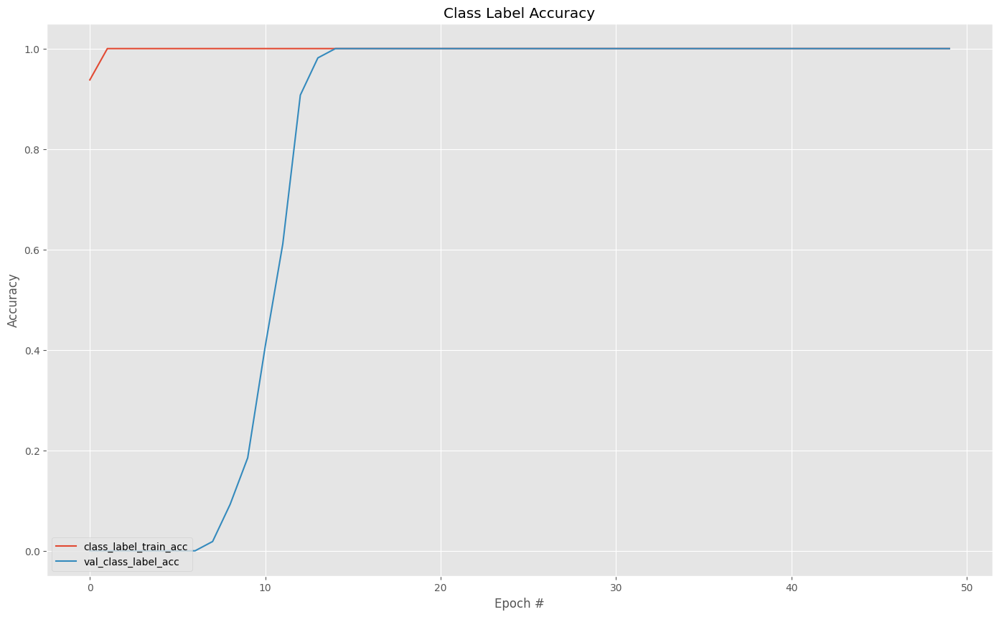

In [14]:
# create a new figure for the accuracies
plt.style.use("ggplot")
plt.figure(figsize=(17, 10))

plt.plot(N, H.history["class_label_accuracy"],
         label="class_label_train_acc")
plt.plot(N, H.history["val_class_label_accuracy"],
         label="val_class_label_acc")

plt.title("Class Label Accuracy")
plt.xlabel("Epoch #")
plt.ylabel("Accuracy")
plt.legend(loc="lower left")

# save the accuracies plot
plotPath = os.path.sep.join(["accs.png"])
plt.savefig(plotPath)

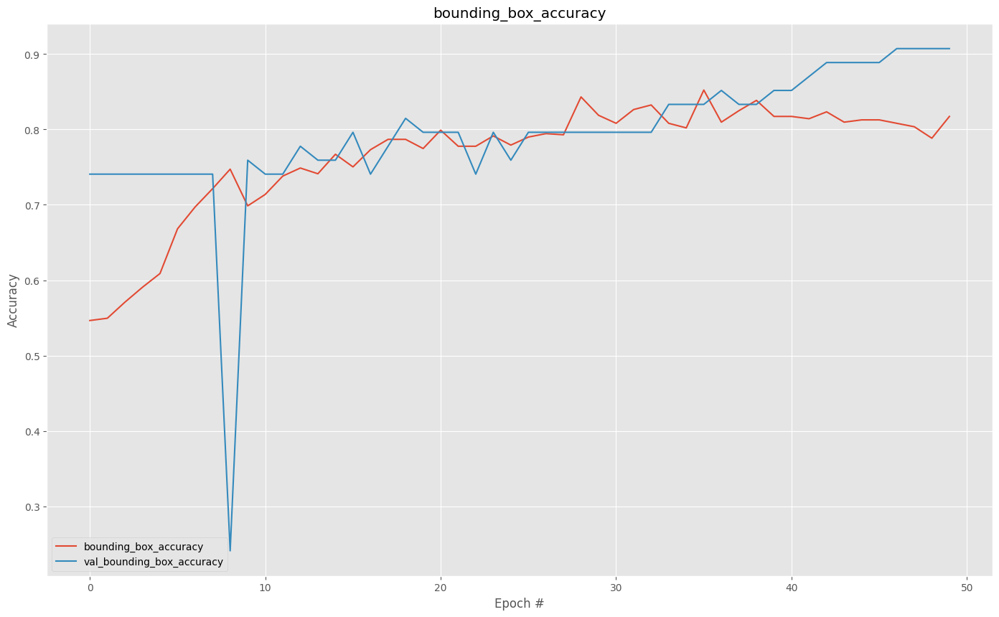

In [15]:
# create a new figure for the accuracies
plt.style.use("ggplot")
plt.figure(figsize=(17, 10))

plt.plot(N, H.history["bounding_box_accuracy"],
         label="bounding_box_accuracy")
plt.plot(N, H.history["val_bounding_box_accuracy"],
         label="val_bounding_box_accuracy")

plt.title("bounding_box_accuracy")
plt.xlabel("Epoch #")
plt.ylabel("Accuracy")
plt.legend(loc="lower left")

# save the accuracies plot
plotPath = os.path.sep.join(["accs.png"])
plt.savefig(plotPath)

In [16]:
imagePaths = testPaths.tolist()
print(len(imagePaths))

54


In [17]:
model.load_weights("/kaggle/working/EfficientNetB0_v2_bbox_regression_excavator.weights.h5")
lb = pickle.loads(open("/kaggle/working/lb.pickle", "rb").read())

In [18]:
import random
import cv2
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import img_to_array, load_img

# ---------------- CONFIG ----------------
NUM_IMAGES = 0            # number of test images to visualize
COLS = 4                   # number of columns in the grid
TARGET_SIZE = (512, 512)   # input size for your model
# ----------------------------------------

def inference_test_set(NUM_IMAGES):
    # pick random test images
    sel_paths = random.sample(imagePaths, NUM_IMAGES)
    
    results = []
    
    for imagePath in sel_paths:
        # load input image for model
        image = load_img(imagePath, target_size=TARGET_SIZE)
        image = img_to_array(image) / 255.0
        image = np.expand_dims(image, axis=0)
    
        # predict
        (boxPreds, labelPreds) = model.predict(image, verbose=0)
        (startX, startY, endX, endY) = boxPreds[0]
    
        i = np.argmax(labelPreds, axis=1)
        label = lb.classes_[i][0]
        confidence = labelPreds[0][i][0]  # confidence score for predicted class
    
        # load original image
        orig = cv2.imread(imagePath)
        (h, w) = orig.shape[:2]
    
        # scale bbox
        startX = int(startX * w)
        startY = int(startY * h)
        endX = int(endX * w)
        endY = int(endY * h)
    
        # draw bbox + label + confidence
        y = startY - 10 if startY - 10 > 10 else startY + 10
        text = f"{label}: {confidence:.2f}"
        cv2.putText(orig, text, (startX, y),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.65, (0, 255, 0), 2)
        cv2.rectangle(orig, (startX, startY), (endX, endY), (0, 255, 0), 2)
    
        # convert to RGB for matplotlib
        results.append(cv2.cvtColor(orig, cv2.COLOR_BGR2RGB))
    
    # --------- visualization grid ----------
    rows = int(np.ceil(NUM_IMAGES / COLS))
    fig, axes = plt.subplots(rows, COLS, figsize=(COLS * 5, rows * 5))
    
    for idx, ax in enumerate(axes.flat):
        if idx < len(results):
            ax.imshow(results[idx].astype("uint8"))
            ax.axis("off")
        else:
            ax.axis("off")
    
    plt.tight_layout()
    plt.show()

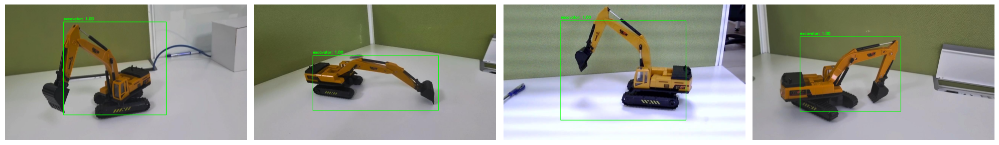

In [23]:
inference_test_set(NUM_IMAGES=4)

In [24]:
import random
import cv2
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import img_to_array, load_img

# ---------------- CONFIG ----------------
NUM_IMAGES = 0            # number of test images to visualize
COLS = 4                   # number of columns in the grid
TARGET_SIZE = (512, 512)   # input size for your model
# ----------------------------------------

def inference_test_set(NUM_IMAGES):
    sel_indices = random.sample(range(len(testPaths)), NUM_IMAGES)
    results = []
    
    for idx in sel_indices:
        imagePath = testPaths[idx]

        # --- Prediction ---
        image = load_img(imagePath, target_size=TARGET_SIZE)
        image = img_to_array(image) / 255.0
        image = np.expand_dims(image, axis=0)
    
        (boxPreds, labelPreds) = model.predict(image, verbose=0)
        (startX, startY, endX, endY) = boxPreds[0]
    
        i = np.argmax(labelPreds, axis=1)[0]
        pred_label = lb.classes_[i]
        confidence = labelPreds[0][i]
    
        # load original image
        orig = cv2.imread(imagePath)
        (h, w) = orig.shape[:2]
    
        # scale predicted bbox
        startX = int(startX * w)
        startY = int(startY * h)
        endX = int(endX * w)
        endY = int(endY * h)

        # --- Ground truth ---
        gt_idx = np.argmax(testLabels[idx])        # one-hot → int
        gt_label = lb.classes_[gt_idx]             # int → class string
        gx1, gy1, gx2, gy2 = testBBoxes[idx]

        # scale GT bbox to pixels
        gx1 = int(gx1 * w)
        gy1 = int(gy1 * h)
        gx2 = int(gx2 * w)
        gy2 = int(gy2 * h)
    
        # draw GT (cyan)
        cv2.rectangle(orig, (gx1, gy1), (gx2, gy2), (255, 255, 0), 2)
        cv2.putText(orig, f"GT: {gt_label}", (gx1, gy1 - 10),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 255, 0), 2)

        # pred color: green if correct, red if wrong
        color = (0, 255, 0) if gt_label == pred_label else (0, 0, 255)

        # draw prediction
        y = startY - 10 if startY - 10 > 10 else startY + 10
        text = f"{pred_label}: {confidence:.2f}"
        cv2.putText(orig, text, (startX, y),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.65, color, 2)
        cv2.rectangle(orig, (startX, startY), (endX, endY), color, 2)
    
        results.append(cv2.cvtColor(orig, cv2.COLOR_BGR2RGB))
    
    # visualization grid
    rows = int(np.ceil(NUM_IMAGES / COLS))
    fig, axes = plt.subplots(rows, COLS, figsize=(COLS * 5, rows * 5))
    
    for idx, ax in enumerate(axes.flat):
        if idx < len(results):
            ax.imshow(results[idx].astype("uint8"))
            ax.axis("off")
        else:
            ax.axis("off")
    
    plt.tight_layout()
    plt.show()

In [25]:
print("One label example:", testLabels[0], type(testLabels[0]))
print("One bbox example:", testBBoxes[0], type(testBBoxes[0]))

One label example: [1 0] <class 'numpy.ndarray'>
One bbox example: [0.14609376 0.04166667 0.7046875  0.9       ] <class 'numpy.ndarray'>


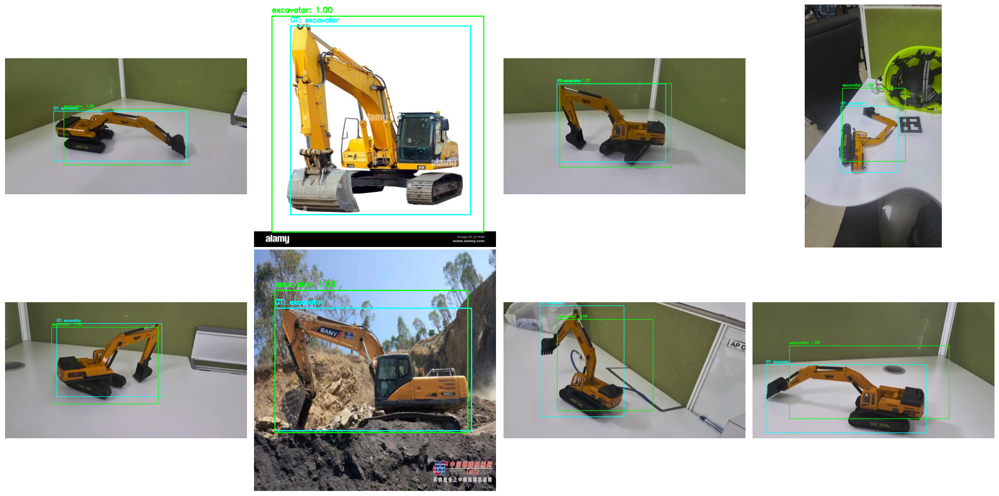

In [26]:
inference_test_set(NUM_IMAGES=8)

In [27]:
import random
import cv2
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import img_to_array, load_img

# ---------------- CONFIG ----------------
NUM_IMAGES = 0            # number of test images to visualize
COLS = 4                  # number of columns in the grid
TARGET_SIZE = (512, 512)  # input size for your model
# ----------------------------------------

def compute_iou(boxA, boxB):
    xA = max(boxA[0], boxB[0])
    yA = max(boxA[1], boxB[1])
    xB = min(boxA[2], boxB[2])
    yB = min(boxA[3], boxB[3])

    interW = max(0, xB - xA)
    interH = max(0, yB - yA)
    interArea = interW * interH

    boxAArea = (boxA[2] - boxA[0]) * (boxA[3] - boxA[1])
    boxBArea = (boxB[2] - boxB[0]) * (boxB[3] - boxB[1])

    iou = interArea / float(boxAArea + boxBArea - interArea + 1e-6)
    return iou

def inference_test_set(NUM_IMAGES):
    sel_indices = random.sample(range(len(testPaths)), NUM_IMAGES)
    results = []
    iou_list = []  # store IoU for subplot titles
    
    for idx in sel_indices:
        imagePath = testPaths[idx]

        # --- Prediction ---
        image = load_img(imagePath, target_size=TARGET_SIZE)
        image = img_to_array(image) / 255.0
        image = np.expand_dims(image, axis=0)
    
        (boxPreds, labelPreds) = model.predict(image, verbose=0)
        (startX, startY, endX, endY) = boxPreds[0]
    
        i = np.argmax(labelPreds, axis=1)[0]
        pred_label = lb.classes_[i]
        confidence = labelPreds[0][i]
    
        # load original image
        orig = cv2.imread(imagePath)
        (h, w) = orig.shape[:2]
    
        # scale predicted bbox
        startX = int(startX * w)
        startY = int(startY * h)
        endX = int(endX * w)
        endY = int(endY * h)

        # --- Ground truth ---
        gt_idx = np.argmax(testLabels[idx])
        gt_label = lb.classes_[gt_idx]
        gx1, gy1, gx2, gy2 = testBBoxes[idx]

        # scale GT bbox
        gx1 = int(gx1 * w)
        gy1 = int(gy1 * h)
        gx2 = int(gx2 * w)
        gy2 = int(gy2 * h)
    
        # draw GT (cyan)
        cv2.rectangle(orig, (gx1, gy1), (gx2, gy2), (255, 255, 0), 2)
        cv2.putText(orig, f"GT: {gt_label}", (gx1, gy1 - 10),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 255, 0), 2)

        # compute IoU
        iou = compute_iou((startX, startY, endX, endY), (gx1, gy1, gx2, gy2))
        iou_list.append(iou)

        # decide pred color
        if gt_label != pred_label:
            color = (0, 0, 255)      # red if class wrong
        elif iou < 0.5:
            color = (0, 255, 255)    # yellow if correct class but low IoU
        else:
            color = (0, 255, 0)      # green if correct and good IoU

        # draw prediction box
        cv2.rectangle(orig, (startX, startY), (endX, endY), color, 2)
        cv2.putText(orig, f"{pred_label}: {confidence:.2f}", 
                    (startX, startY - 10 if startY - 10 > 10 else startY + 10),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.65, color, 2)
    
        results.append(cv2.cvtColor(orig, cv2.COLOR_BGR2RGB))
    
    # visualization grid
    rows = int(np.ceil(NUM_IMAGES / COLS))
    fig, axes = plt.subplots(rows, COLS, figsize=(COLS * 5, rows * 5))
    
    for idx, ax in enumerate(axes.flat):
        if idx < len(results):
            ax.imshow(results[idx].astype("uint8"))
            ax.axis("off")
            ax.set_title(f"IoU: {iou_list[idx]:.4f}", fontsize=15)
        else:
            ax.axis("off")
    
    plt.tight_layout()
    plt.show()

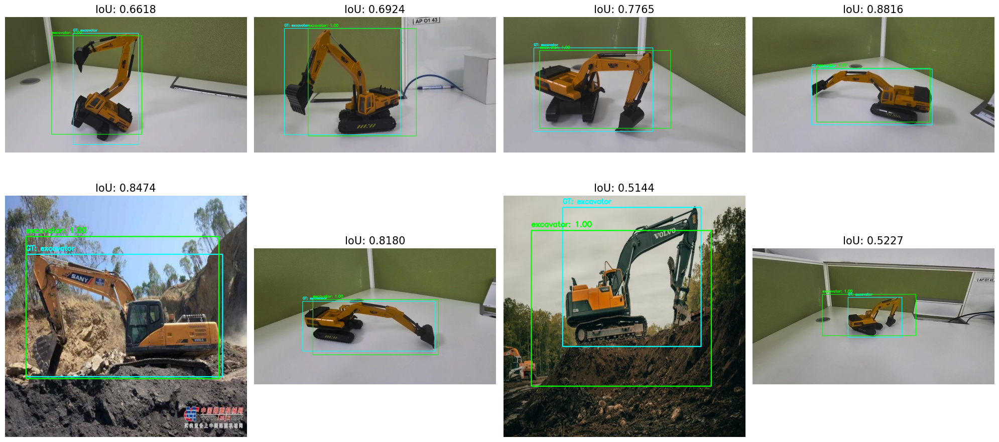

In [28]:
inference_test_set(NUM_IMAGES=8)

In [30]:
import numpy as np

# ---------------- CONFIG ----------------
IOU_THRESH = 0.5
CONF_THRESH = 0.5
# ----------------------------------------

def compute_iou(boxA, boxB):
    xA = max(boxA[0], boxB[0])
    yA = max(boxA[1], boxB[1])
    xB = min(boxA[2], boxB[2])
    yB = min(boxA[3], boxB[3])

    interW = max(0, xB - xA)
    interH = max(0, yB - yA)
    interArea = interW * interH

    boxAArea = (boxA[2] - boxA[0]) * (boxA[3] - boxA[1])
    boxBArea = (boxB[2] - boxB[0]) * (boxB[3] - boxB[1])

    iou = interArea / float(boxAArea + boxBArea - interArea + 1e-6)
    return iou

def evaluate_test_set():
    TP = 0
    FP = 0
    FN = 0

    for idx in range(len(testPaths)):
        imagePath = testPaths[idx]

        # --- Prediction ---
        image = load_img(imagePath, target_size=TARGET_SIZE)
        image = img_to_array(image) / 255.0
        image = np.expand_dims(image, axis=0)
    
        (boxPreds, labelPreds) = model.predict(image, verbose=0)
        (startX, startY, endX, endY) = boxPreds[0]
    
        i = np.argmax(labelPreds, axis=1)[0]
        pred_label = lb.classes_[i]
        confidence = labelPreds[0][i]

        if confidence < CONF_THRESH:
            # skip low-confidence predictions
            pred_label = None

        # scale pred bbox
        orig = cv2.imread(imagePath)
        h, w = orig.shape[:2]
        startX = int(startX * w)
        startY = int(startY * h)
        endX = int(endX * w)
        endY = int(endY * h)

        pred_box = (startX, startY, endX, endY)

        # --- Ground truth ---
        gt_idx = np.argmax(testLabels[idx])
        gt_label = lb.classes_[gt_idx]
        gx1, gy1, gx2, gy2 = testBBoxes[idx]
        gx1 = int(gx1 * w)
        gy1 = int(gy1 * h)
        gx2 = int(gx2 * w)
        gy2 = int(gy2 * h)
        gt_box = (gx1, gy1, gx2, gy2)

        # --- Compare ---
        if pred_label is not None:
            iou = compute_iou(pred_box, gt_box)
            if pred_label == gt_label and iou >= IOU_THRESH:
                TP += 1
            else:
                FP += 1
                FN += 1  # count missed GT as FN
        else:
            FN += 1  # missed prediction

    # --- Compute metrics ---
    precision = TP / (TP + FP + 1e-6)
    recall = TP / (TP + FN + 1e-6)
    f1 = 2 * precision * recall / (precision + recall + 1e-6)

    print(f"Test set size: {len(testPaths)}")
    print(f"TP: {TP}, FP: {FP}, FN: {FN}")
    print(f"Precision: {precision:.4f}")
    print(f"Recall:    {recall:.4f}")
    print(f"F1-score:  {f1:.4f}")

# Call evaluation
evaluate_test_set()

Test set size: 54
TP: 50, FP: 4, FN: 4
Precision: 0.9259
Recall:    0.9259
F1-score:  0.9259


In [31]:
model.load_weights("/kaggle/working/EfficientNetB0_v2_bbox_regression_excavator.weights.h5")
lb = pickle.loads(open("/kaggle/working/lb.pickle", "rb").read())

In [32]:
import os
import random
import cv2
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import img_to_array, load_img

# ---------------- CONFIG ----------------
TEST_FOLDER = "/test-images/"  # path to folder with images
NUM_IMAGES = 0                 # number of images to visualize
COLS = 4                       # number of columns in grid
TARGET_SIZE = (512, 512)       # input size for model
# ----------------------------------------

def inference_from_folder(folder_path=TEST_FOLDER, NUM_IMAGES=NUM_IMAGES, conf_thresh=0.5):
    """
    Run inference on images in folder_path.

    Args:
        folder_path: str, path to image folder
        NUM_IMAGES: int, number of images to visualize (0 = all)
        conf_thresh: float, minimum confidence to draw prediction
    """
    # --- collect all images ---
    exts = (".jpg", ".jpeg", ".png", ".bmp")
    imagePaths = [os.path.join(folder_path, f) for f in os.listdir(folder_path)
                  if f.lower().endswith(exts)]
    
    if len(imagePaths) == 0:
        print(f"No images found in {folder_path}")
        return
    
    # pick random images
    sel_paths = random.sample(imagePaths, min(NUM_IMAGES if NUM_IMAGES>0 else len(imagePaths), len(imagePaths)))
    
    results = []
    
    for imagePath in sel_paths:
        try:
            # load input image for model
            image = load_img(imagePath, target_size=TARGET_SIZE)
            image = img_to_array(image) / 255.0
            image = np.expand_dims(image, axis=0)
        except Exception as e:
            print(f"Skipping {imagePath}: {e}")
            continue
    
        # predict
        (boxPreds, labelPreds) = model.predict(image, verbose=0)
        (startX, startY, endX, endY) = boxPreds[0]
    
        i = np.argmax(labelPreds, axis=1)[0]
        label = lb.classes_[i]
        confidence = labelPreds[0][i]
    
        # load original image
        orig = cv2.imread(imagePath)
        if orig is None:
            print(f"Skipping {imagePath}: cv2.imread failed")
            continue
        (h, w) = orig.shape[:2]
    
        # scale bbox
        startX = int(startX * w)
        startY = int(startY * h)
        endX = int(endX * w)
        endY = int(endY * h)
    
        # draw prediction only if confidence >= conf_thresh
        if confidence >= conf_thresh:
            color = (0, 255, 0)
            y = startY - 10 if startY - 10 > 10 else startY + 10
            text = f"{label}: {confidence:.2f}"
            cv2.putText(orig, text, (startX, y),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.65, color, 2)
            cv2.rectangle(orig, (startX, startY), (endX, endY), color, 2)
        else:
            # optionally, show label as "low conf" in gray
            y = startY - 10 if startY - 10 > 10 else startY + 10
            cv2.putText(orig, f"{label}: {confidence:.2f}", (startX, y),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.65, (100, 100, 100), 1)
    
        results.append(cv2.cvtColor(orig, cv2.COLOR_BGR2RGB))
    
    if len(results) == 0:
        print("No valid images to display.")
        return

    # --------- visualization grid ----------
    rows = int(np.ceil(len(results) / COLS))
    fig, axes = plt.subplots(rows, COLS, figsize=(COLS * 5, rows * 5))
    
    for idx, ax in enumerate(axes.flat):
        if idx < len(results):
            ax.imshow(results[idx].astype("uint8"))
            ax.axis("off")
        else:
            ax.axis("off")
    
    plt.tight_layout()
    plt.show()

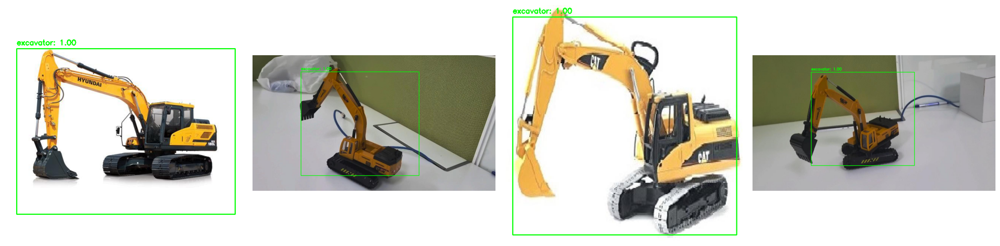

In [35]:
inference_from_folder("/kaggle/input/excavator/excavator/valid", NUM_IMAGES=4, conf_thresh=0.5)

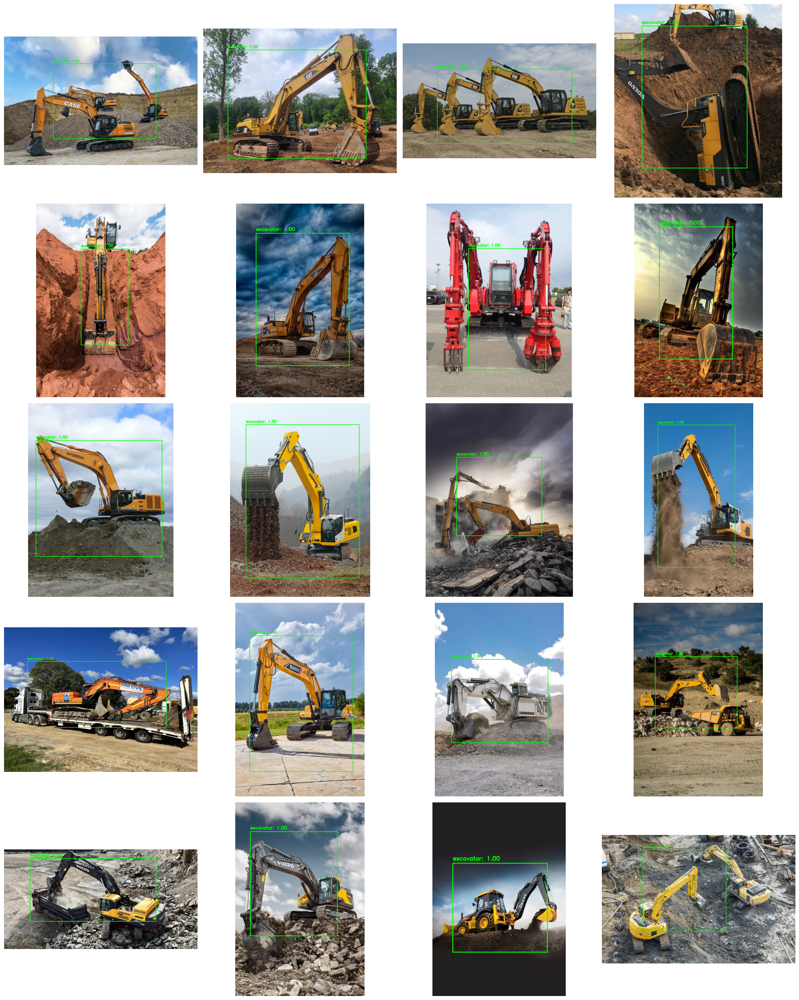

In [38]:
inference_from_folder("/kaggle/input/excavators-test/excavators-test", NUM_IMAGES=20, conf_thresh=0.5)

In [39]:
# Serialize the model as a SavedModel.
# Use model.export for Keras models
model.export("EfficientNetB0_v2_bbox_regression")

import tensorflow as tf
# Convert to TFLite. This form of quantization is called
# post-training dynamic-range quantization in TFLite.
converter = tf.lite.TFLiteConverter.from_saved_model("EfficientNetB0_v2_bbox_regression")
# No optimizations
tflite_model = converter.convert()
open("EfficientNetB0_v2_bbox_regression_excavator.tflite", "wb").write(tflite_model)

/usr/local/lib/python3.11/dist-packages/keras/src/models/functional.py:237: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: ['keras_tensor_248']
Received: inputs=Tensor(shape=(None, 512, 512, 3))
  warnings.warn(msg)


Saved artifact at 'EfficientNetB0_v2_bbox_regression'. The following endpoints are available:

* Endpoint 'serve'
  args_0 (POSITIONAL_ONLY): TensorSpec(shape=(None, 512, 512, 3), dtype=tf.float32, name='keras_tensor_248')
Output Type:
  List[TensorSpec(shape=(None, 4), dtype=tf.float32, name=None), TensorSpec(shape=(None, 2), dtype=tf.float32, name=None)]
Captures:
  137672430349648: TensorSpec(shape=(1, 1, 1, 3), dtype=tf.float32, name=None)
  137672430347536: TensorSpec(shape=(1, 1, 1, 3), dtype=tf.float32, name=None)
  137674885607120: TensorSpec(shape=(), dtype=tf.resource, name=None)
  137674885607504: TensorSpec(shape=(), dtype=tf.resource, name=None)
  137674885608464: TensorSpec(shape=(), dtype=tf.resource, name=None)
  137674885607696: TensorSpec(shape=(), dtype=tf.resource, name=None)
  137674885605392: TensorSpec(shape=(), dtype=tf.resource, name=None)
  137674885609424: TensorSpec(shape=(), dtype=tf.resource, name=None)
  137674885609040: TensorSpec(shape=(), dtype=tf.reso

W0000 00:00:1759847061.969855      37 tf_tfl_flatbuffer_helpers.cc:365] Ignored output_format.
W0000 00:00:1759847061.969906      37 tf_tfl_flatbuffer_helpers.cc:368] Ignored drop_control_dependency.
I0000 00:00:1759847062.143196      37 mlir_graph_optimization_pass.cc:401] MLIR V1 optimization pass is not enabled


31403492

In [40]:
import os
import random
import cv2
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import img_to_array, load_img
import tensorflow as tf
import pickle

# ---------------- CONFIG ----------------
MODEL_PATH = "/kaggle/working/EfficientNetB0_v2_bbox_regression_excavator.tflite"
TEST_FOLDER = "/test-images/"  # path to folder with images
NUM_IMAGES = 0                 # number of images to visualize (0 = all)
COLS = 4                       # number of columns in grid
lb = pickle.loads(open("/kaggle/working/lb.pickle", "rb").read())
# NOTE: TARGET_SIZE will be taken from the TFLite model input shape below
# ----------------------------------------

# --------- Load TFLite model & metadata ----------
interpreter = tf.lite.Interpreter(model_path=MODEL_PATH)
interpreter.allocate_tensors()
input_details = interpreter.get_input_details()
output_details = interpreter.get_output_details()

# get expected input size from TFLite model (H,W)
tflite_input_hw = tuple(input_details[0]['shape'][1:3])
TARGET_SIZE = (int(tflite_input_hw[0]), int(tflite_input_hw[1]))

# convenience values for quantization
input_index = input_details[0]['index']
input_dtype = input_details[0]['dtype']
input_qscale, input_qzero = input_details[0].get('quantization', (0.0, 0))

# helper: run interpreter on a preprocessed image array and return dequantized outputs
def run_tflite_inference(prepped_input):
    # prepped_input: numpy array shaped (1,H,W,3) normalized to [0..1] (float32) — we'll quantize if needed
    if input_dtype == np.uint8 or input_dtype == np.int8:
        if input_qscale and input_qscale != 0:
            q = (prepped_input / input_qscale + input_qzero).round().astype(input_dtype)
        else:
            q = prepped_input.astype(input_dtype)
        interpreter.set_tensor(input_index, q)
    else:
        interpreter.set_tensor(input_index, prepped_input.astype(input_dtype))

    interpreter.invoke()

    # gather outputs and dequantize if necessary
    outs = []
    for od in output_details:
        raw = interpreter.get_tensor(od['index'])
        oq_scale, oq_zero = od.get('quantization', (0.0, 0))
        if oq_scale and oq_scale != 0:
            raw = (raw.astype(np.float32) - oq_zero) * oq_scale
        else:
            raw = raw.astype(np.float32)
        outs.append(raw)

    # try to identify box vs label outputs:
    box_out = None
    label_out = None
    for out in outs:
        # box likely has last dim == 4
        if out.ndim >= 2 and out.shape[-1] == 4:
            box_out = out
        # label scores: 2D with many classes in last dim
        elif out.ndim == 2 and out.shape[-1] > 4:
            label_out = out
    # fallback assignments
    if box_out is None and len(outs) >= 1:
        box_out = outs[0]
    if label_out is None and len(outs) >= 2:
        label_out = outs[1]

    return box_out, label_out

# --------- Inference function using TFLite ----------
def inference_from_folder_tflite(folder_path=TEST_FOLDER,
                                 NUM_IMAGES=NUM_IMAGES,
                                 conf_thresh=0.5,
                                 cols=COLS):
    """
    Run inference using TFLite model on images in folder_path.
    - Draw predicted bbox only if confidence >= conf_thresh (else show low-conf gray text).
    - Always display the images selected.
    """
    exts = (".jpg", ".jpeg", ".png", ".bmp")
    all_files = sorted(os.listdir(folder_path))
    imagePaths = [os.path.join(folder_path, f) for f in all_files if f.lower().endswith(exts)]

    if len(imagePaths) == 0:
        print(f"No images found in {folder_path}")
        return

    # pick random images (or all if NUM_IMAGES==0)
    Npick = min(NUM_IMAGES if NUM_IMAGES > 0 else len(imagePaths), len(imagePaths))
    sel_paths = random.sample(imagePaths, Npick)

    results = []

    for imagePath in sel_paths:
        # load & preprocess for model
        try:
            pil = load_img(imagePath, target_size=TARGET_SIZE)
            inp = img_to_array(pil)  # shape (H,W,3), dtype float32 with 0..255
            inp = inp / 255.0  # normalize to 0..1 (same preprocessing as before)
            inp = np.expand_dims(inp, axis=0).astype(np.float32)
        except Exception as e:
            print(f"Skipping (cannot load) {imagePath}: {e}")
            continue

        # run tflite
        boxPreds, labelPreds = run_tflite_inference(inp)

        # basic sanity checks
        if boxPreds is None:
            print(f"Skipping {imagePath}: no box output from TFLite")
            continue

        # boxPreds expected shape: (1,4)
        box = boxPreds[0].astype(np.float32)  # normalized coords (x1,y1,x2,y2) expected
        # labelPreds may be None, 1D, or 2D. Handle robustly:
        pred_label = None
        confidence = 0.0
        if labelPreds is not None:
            lp = labelPreds
            if lp.ndim == 2:
                # (1, num_classes)
                idx = int(np.argmax(lp, axis=1)[0])
                confidence = float(lp[0, idx])
                try:
                    pred_label = lb.classes_[idx]
                except Exception:
                    pred_label = str(idx)
            elif lp.ndim == 1:
                # (num_classes,) or (1,)
                if lp.size > 1:
                    idx = int(np.argmax(lp))
                    confidence = float(lp[idx])
                    try:
                        pred_label = lb.classes_[idx]
                    except Exception:
                        pred_label = str(idx)
                else:
                    # maybe single scalar class index
                    idx = int(lp[0])
                    confidence = 1.0
                    try:
                        pred_label = lb.classes_[idx]
                    except Exception:
                        pred_label = str(idx)
        else:
            pred_label = "N/A"
            confidence = 0.0

        # load original image with OpenCV for drawing & size
        orig = cv2.imread(imagePath)
        if orig is None:
            print(f"Skipping {imagePath}: cv2.imread failed")
            continue
        (h, w) = orig.shape[:2]

        # scale predicted bbox (assume box normalized [0..1])
        startX = int(box[0] * w)
        startY = int(box[1] * h)
        endX   = int(box[2] * w)
        endY   = int(box[3] * h)

        # draw prediction only if confidence >= conf_thresh
        if confidence >= conf_thresh:
            color = (0, 255, 0)  # green
            y = startY - 10 if startX >= 0 and startY - 10 > 10 else startY + 10
            text = f"{pred_label}: {confidence:.2f}"
            cv2.putText(orig, text, (max(startX,5), max(y,12)),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.65, color, 2)
            cv2.rectangle(orig, (startX, startY), (endX, endY), color, 2)
        else:
            # show low confidence prediction as gray text (no box)
            y = startY - 10 if startX >= 0 and startY - 10 > 10 else startY + 10
            cv2.putText(orig, f"{pred_label}: {confidence:.2f}", (max(startX,5), max(y,12)),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.65, (100, 100, 100), 1)

        results.append(cv2.cvtColor(orig, cv2.COLOR_BGR2RGB))

    if len(results) == 0:
        print("No valid images to display.")
        return

    # visualization grid
    rows = int(np.ceil(len(results) / cols))
    fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 5))
    axes_flat = axes.flat if hasattr(axes, "flat") else [axes]

    for idx, ax in enumerate(axes_flat):
        if idx < len(results):
            ax.imshow(results[idx].astype("uint8"))
            ax.axis("off")
        else:
            ax.axis("off")

    plt.tight_layout()
    plt.show()

INFO: Created TensorFlow Lite XNNPACK delegate for CPU.


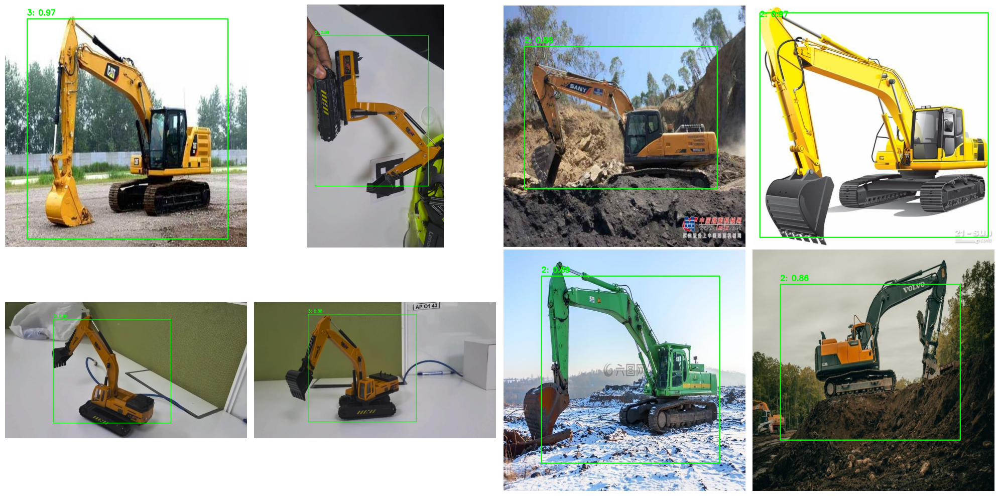

In [41]:
inference_from_folder_tflite("/kaggle/input/excavator/excavator/valid", NUM_IMAGES=8, conf_thresh=0.5)

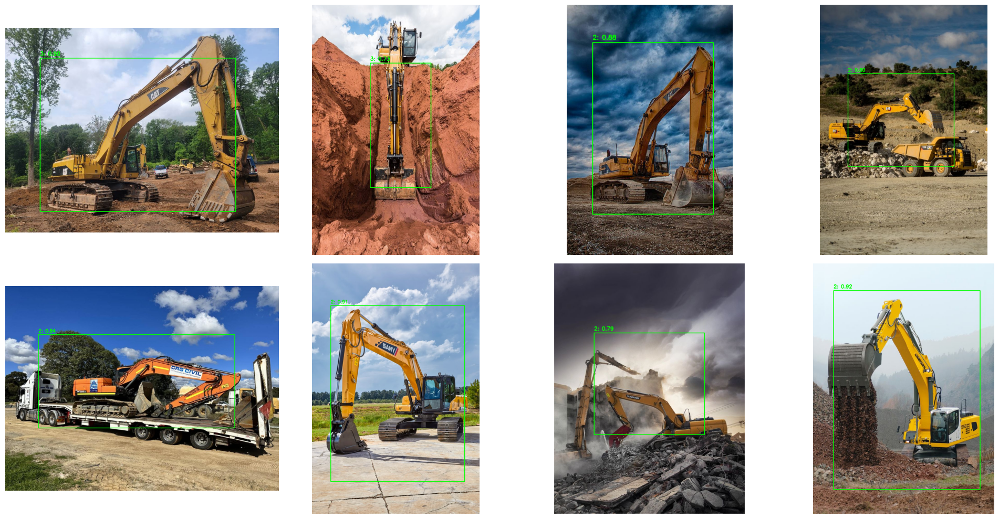

In [42]:
inference_from_folder_tflite("/kaggle/input/excavators-test/excavators-test", NUM_IMAGES=8, conf_thresh=0.5)